<a href="https://colab.research.google.com/github/quasar-in-the-mist/Plate-Tectonics/blob/main/PT_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
# #!/usr/bin/env python3
# """
# Tolkien-Style Fantasy Map Generator
# Generates a procedural continent with tectonic plates, terrain classification,
# river systems, forests, deserts, and renders it in a hand-drawn ink style
# with Tengwar-inspired naming conventions.
# """

# !pip install numpy scipy matplotlib noise

# import numpy as np
# from scipy.ndimage import gaussian_filter, label, binary_dilation, distance_transform_edt
# from scipy.spatial import Voronoi
# from collections import deque
# import matplotlib.pyplot as plt
# import matplotlib.colors as mcolors
# from matplotlib.patches import FancyArrowPatch
# from matplotlib.font_manager import FontProperties
# import matplotlib.patheffects as path_effects
# from noise import pnoise2
# import random
# import string
# import os



# # ──────────────────────────────────────────────────────────────────────────────
# # CONFIGURATION
# # ──────────────────────────────────────────────────────────────────────────────

# class Config:
#     SEED = None  # Set to int for reproducibility, None for random
#     WIDTH = 512
#     HEIGHT = 512
#     NUM_PLATES = 18
#     SEA_LEVEL = 0.38
#     MOUNTAIN_THRESHOLD = 0.78
#     HIGH_MOUNTAIN_THRESHOLD = 0.88
#     SNOW_ALTITUDE = 0.92
#     FOREST_MOISTURE_THRESHOLD = 0.45
#     DESERT_MOISTURE_THRESHOLD = 0.15
#     NUM_RIVERS = 35
#     RIVER_MIN_LENGTH = 30
#     OUTPUT_FILE = "tolkien_map.png"
#     DPI = 300
#     FIGURE_SIZE = (24, 24)


# # ──────────────────────────────────────────────────────────────────────────────
# # TENGWAR-INSPIRED NAME GENERATOR
# # ──────────────────────────────────────────────────────────────────────────────

# class QuenyaNameGenerator:
#     """Generates Tolkien-flavored (Quenya/Sindarin-inspired) place names."""

#     PREFIXES_MOUNTAIN = [
#         "Orod", "Carak", "Taniquetil", "Mindol", "Baraz",
#         "Celebdil", "Fanu", "Hithae", "Ered", "Ephel"
#     ]
#     SUFFIXES_MOUNTAIN = [
#         "duin", "ras", "luin", "gûl", "horn",
#         "dhûr", "rim", "mîr", "thang", "nost"
#     ]
#     PREFIXES_FOREST = [
#         "Taur", "Eryn", "Fangorn", "Nan", "Lothl",
#         "Nimb", "Brethil", "Dorth", "Green", "Celeb"
#     ]
#     SUFFIXES_FOREST = [
#         "órien", "galen", "waith", "aith", "orn",
#         "rethil", "galadh", "wood", "dor", "iant"
#     ]
#     PREFIXES_RIVER = [
#         "Sîr", "Anduin", "Celeb", "Baran", "Nenu",
#         "Glan", "Mith", "Brui", "Aros", "Gelion"
#     ]
#     SUFFIXES_RIVER = [
#         "iant", "uin", "rant", "duin", "lhîn",
#         "nen", "ros", "thir", "los", "gwaith"
#     ]
#     PREFIXES_DESERT = [
#         "Lith", "Anfau", "Ered", "Dor", "Lothlann",
#         "Agar", "Hara", "Forn"
#     ]
#     SUFFIXES_DESERT = [
#         "lad", "glir", "nûr", "goroth", "waith",
#         "mbar", "dor", "eng"
#     ]
#     PREFIXES_BAY = [
#         "Balar", "Eldal", "Loth", "Cirith", "Fal",
#         "Tol", "Ving", "Rôm"
#     ]
#     SUFFIXES_BAY = [
#         "ondë", "assë", "aith", "lond", "obel",
#         "edhel", "annûn", "arthad"
#     ]
#     PREFIXES_LAKE = [
#         "Nen", "Lhin", "Ael", "Hith", "Mir",
#         "Celebr", "Ivrin", "Úm"
#     ]
#     SUFFIXES_LAKE = [
#         "ial", "uial", "nen", "lith", "riel",
#         "orn", "wing", "dil"
#     ]
#     PREFIXES_PEAK = [
#         "Amon", "Caran", "Minas", "Bar", "Celebr",
#         "Orthanc", "Fanu", "Aeglos"
#     ]
#     SUFFIXES_PEAK = [
#         "rûdh", "sûl", "tirith", "amarth", "aglar",
#         "rîn", "gûl", "thalion"
#     ]
#     PREFIXES_GRASSLAND = [
#         "Nan", "Talf", "Glad", "Parf", "Calen",
#         "Roh", "Emyn", "Parth"
#     ]
#     SUFFIXES_GRASSLAND = [
#         "tasarion", "galen", "den", "dirith", "iant",
#         "waith", "irith", "enedh"
#     ]

#     def __init__(self, seed=None):
#         self.rng = random.Random(seed)
#         self.used_names = set()

#     def _gen(self, prefixes, suffixes):
#         for _ in range(100):
#             name = self.rng.choice(prefixes) + self.rng.choice(suffixes)
#             if name not in self.used_names:
#                 self.used_names.add(name)
#                 return name
#         # Fallback
#         name = self.rng.choice(prefixes) + self.rng.choice(suffixes) + str(self.rng.randint(1, 99))
#         self.used_names.add(name)
#         return name

#     def mountain_range(self):
#         return self._gen(self.PREFIXES_MOUNTAIN, self.SUFFIXES_MOUNTAIN)

#     def forest(self):
#         return self._gen(self.PREFIXES_FOREST, self.SUFFIXES_FOREST)

#     def river(self):
#         return self._gen(self.PREFIXES_RIVER, self.SUFFIXES_RIVER)

#     def desert(self):
#         return self._gen(self.PREFIXES_DESERT, self.SUFFIXES_DESERT)

#     def bay(self):
#         return self._gen(self.PREFIXES_BAY, self.SUFFIXES_BAY)

#     def lake(self):
#         return self._gen(self.PREFIXES_LAKE, self.SUFFIXES_LAKE)

#     def peak(self):
#         return self._gen(self.PREFIXES_PEAK, self.SUFFIXES_PEAK)

#     def grassland(self):
#         return self._gen(self.PREFIXES_GRASSLAND, self.SUFFIXES_GRASSLAND)


# # ──────────────────────────────────────────────────────────────────────────────
# # WORLD GENERATION ENGINE
# # ──────────────────────────────────────────────────────────────────────────────

# class WorldGenerator:
#     def __init__(self, cfg: Config):
#         self.cfg = cfg
#         self.seed = cfg.SEED if cfg.SEED is not None else random.randint(0, 999999)
#         self.rng = np.random.RandomState(self.seed)
#         random.seed(self.seed)
#         self.W = cfg.WIDTH
#         self.H = cfg.HEIGHT

#         # Lattice arrays
#         self.altitude = np.zeros((self.H, self.W), dtype=np.float64)
#         self.moisture = np.zeros((self.H, self.W), dtype=np.float64)
#         self.terrain = np.full((self.H, self.W), 'ocean', dtype='U16')
#         self.plate_id = np.zeros((self.H, self.W), dtype=np.int32)
#         self.river_map = np.zeros((self.H, self.W), dtype=np.float64)
#         self.rivers = []  # list of list-of-(y,x) paths
#         self.features = {}  # {name: (type, y, x)} for labeling

#     # ── Tectonic Plates via Voronoi ──────────────────────────────────────
#     def generate_plates(self):
#         """Create irregular tectonic plates using Voronoi tessellation."""
#         n = self.cfg.NUM_PLATES
#         seeds_x = self.rng.randint(0, self.W, size=n)
#         seeds_y = self.rng.randint(0, self.H, size=n)
#         plate_centers = np.stack([seeds_y, seeds_x], axis=-1).astype(float)

#         # Assign each cell to nearest plate (with slight noise for irregularity)
#         yy, xx = np.mgrid[0:self.H, 0:self.W]
#         noise_field = self.rng.randn(self.H, self.W) * 12.0  # irregularity

#         for y in range(self.H):
#             for x in range(self.W):
#                 dists = np.sqrt((plate_centers[:, 0] - y)**2 + (plate_centers[:, 1] - x)**2)
#                 dists += self.rng.randn(n) * 15  # jitter distance
#                 self.plate_id[y, x] = np.argmin(dists)

#         # Each plate gets a random drift vector and a base altitude tendency
#         self.plate_drift = self.rng.randn(n, 2) * 2.0
#         self.plate_base = self.rng.uniform(-0.2, 0.5, size=n)

#         # Some plates are oceanic (lower base)
#         oceanic = self.rng.choice(n, size=n // 3, replace=False)
#         self.plate_base[oceanic] -= 0.4

#         print(f"  [plates] {n} plates, {len(oceanic)} oceanic, seed={self.seed}")

#     # ── Altitude from plate interactions ─────────────────────────────────
#     def generate_altitude(self):
#         """Build altitude from plate collisions, Perlin noise, and edge effects."""
#         H, W, n = self.H, self.W, self.cfg.NUM_PLATES

#         # Start with plate base altitude
#         alt = np.zeros((H, W), dtype=np.float64)
#         for pid in range(n):
#             mask = self.plate_id == pid
#             alt[mask] = self.plate_base[pid]

#         # Detect plate boundaries and classify convergent/divergent
#         boundary = np.zeros((H, W), dtype=bool)
#         for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
#             shifted = np.roll(np.roll(self.plate_id, dy, axis=0), dx, axis=1)
#             boundary |= (self.plate_id != shifted)

#         # At boundaries, compute collision intensity
#         collision = np.zeros((H, W), dtype=np.float64)
#         for y in range(1, H - 1):
#             for x in range(1, W - 1):
#                 if not boundary[y, x]:
#                     continue
#                 pid_a = self.plate_id[y, x]
#                 neighbors = set()
#                 for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
#                     nb = self.plate_id[y + dy, x + dx]
#                     if nb != pid_a:
#                         neighbors.add(nb)
#                 for pid_b in neighbors:
#                     # Relative drift toward each other
#                     da = self.plate_drift[pid_a]
#                     db = self.plate_drift[pid_b]
#                     # Direction from a center to b center — simplified: just use drift opposition
#                     convergence = np.dot(da - db, da - db)
#                     collision[y, x] = max(collision[y, x], convergence)

#         # Smooth and normalize collision
#         collision = gaussian_filter(collision, sigma=8)
#         if collision.max() > 0:
#             collision /= collision.max()

#         # Mountains at convergent boundaries
#         alt += collision * 0.7

#         # Add multi-octave Perlin noise for natural variation
#         scale1, scale2, scale3 = 120.0, 60.0, 30.0
#         ox, oy = self.rng.uniform(0, 1000, size=2)
#         for y in range(H):
#             for x in range(W):
#                 n1 = pnoise2((x + ox) / scale1, (y + oy) / scale1, octaves=4)
#                 n2 = pnoise2((x + ox) / scale2, (y + oy) / scale2, octaves=4) * 0.5
#                 n3 = pnoise2((x + ox) / scale3, (y + oy) / scale3, octaves=3) * 0.25
#                 alt[y, x] += (n1 + n2 + n3) * 0.35

#         # Edge falloff — pushes borders toward ocean
#         cy, cx = H / 2, W / 2
#         yy, xx = np.mgrid[0:H, 0:W]
#         dist_from_center = np.sqrt(((yy - cy) / cy) ** 2 + ((xx - cx) / cx) ** 2)
#         falloff = 1.0 - np.clip(dist_from_center * 1.1, 0, 1) ** 2
#         alt *= falloff

#         # Normalize to [0, 1]
#         alt -= alt.min()
#         if alt.max() > 0:
#             alt /= alt.max()

#         # Slight gaussian smooth for realism
#         alt = gaussian_filter(alt, sigma=2)

#         self.altitude = alt
#         print(f"  [altitude] range [{alt.min():.3f}, {alt.max():.3f}]")

#     # ── Classify terrain cells ───────────────────────────────────────────
#     def classify_terrain(self):
#         """First pass: ocean vs land, mountains, snow peaks."""
#         H, W = self.H, self.W
#         sl = self.cfg.SEA_LEVEL

#         for y in range(H):
#             for x in range(W):
#                 a = self.altitude[y, x]
#                 if a < sl:
#                     self.terrain[y, x] = 'ocean'
#                 elif a >= self.cfg.SNOW_ALTITUDE:
#                     self.terrain[y, x] = 'snow'
#                 elif a >= self.cfg.HIGH_MOUNTAIN_THRESHOLD:
#                     self.terrain[y, x] = 'high_mountain'
#                 elif a >= self.cfg.MOUNTAIN_THRESHOLD:
#                     self.terrain[y, x] = 'mountain'
#                 else:
#                     self.terrain[y, x] = 'land'  # to be refined

#         land_count = np.sum(self.terrain != 'ocean')
#         print(f"  [terrain] land cells: {land_count} / {H * W}")

#     # ── River generation ─────────────────────────────────────────────────
#     def generate_rivers(self):
#         """Trace rivers from high altitude downhill to the sea."""
#         H, W = self.H, self.W
#         sl = self.cfg.SEA_LEVEL
#         land = self.altitude >= sl

#         # Find high-altitude starting points
#         candidates = []
#         for y in range(2, H - 2):
#             for x in range(2, W - 2):
#                 a = self.altitude[y, x]
#                 if a > self.cfg.MOUNTAIN_THRESHOLD and land[y, x]:
#                     candidates.append((a, y, x))
#         candidates.sort(key=lambda t: -t[0])

#         used = np.zeros((H, W), dtype=bool)

#         directions = [(-1, -1), (-1, 0), (-1, 1),
#                       (0, -1),           (0, 1),
#                       (1, -1),  (1, 0),  (1, 1)]

#         rivers = []
#         for _, sy, sx in candidates[:self.cfg.NUM_RIVERS * 4]:
#             if used[sy, sx]:
#                 continue
#             path = [(sy, sx)]
#             visited = {(sy, sx)}
#             y, x = sy, sx

#             for _ in range(2000):
#                 # Move to lowest neighbor
#                 best_a = self.altitude[y, x]
#                 best_pos = None
#                 # Add slight randomness to avoid straight lines
#                 shuffled = list(directions)
#                 random.shuffle(shuffled)
#                 for dy, dx in shuffled:
#                     ny, nx = y + dy, x + dx
#                     if 0 <= ny < H and 0 <= nx < W and (ny, nx) not in visited:
#                         na = self.altitude[ny, nx] + self.rng.uniform(-0.005, 0.005)
#                         if na < best_a:
#                             best_a = na
#                             best_pos = (ny, nx)
#                 if best_pos is None:
#                     break
#                 y, x = best_pos
#                 path.append((y, x))
#                 visited.add((y, x))
#                 if self.altitude[y, x] < sl:
#                     break  # reached ocean

#             if len(path) >= self.cfg.RIVER_MIN_LENGTH:
#                 rivers.append(path)
#                 for py, px in path:
#                     used[py, px] = True
#                     self.river_map[py, px] += 1.0

#             if len(rivers) >= self.cfg.NUM_RIVERS:
#                 break

#         self.rivers = rivers
#         # Spread moisture from rivers
#         self.river_map = gaussian_filter(self.river_map, sigma=6)
#         print(f"  [rivers] {len(rivers)} rivers generated")

#     # ── Moisture and secondary terrain ───────────────────────────────────
#     def generate_moisture_and_biomes(self):
#         """Compute moisture from rivers/coast, then assign forests, deserts, grasslands."""
#         H, W = self.H, self.W
#         sl = self.cfg.SEA_LEVEL

#         # Distance from ocean
#         ocean_mask = self.altitude < sl
#         dist_ocean = distance_transform_edt(~ocean_mask).astype(np.float64)
#         dist_ocean /= max(dist_ocean.max(), 1.0)

#         # Moisture = proximity to water (ocean + rivers) + noise
#         coastal_moisture = 1.0 - np.clip(dist_ocean * 2.5, 0, 1)
#         river_moisture = np.clip(self.river_map * 3.0, 0, 1)

#         ox2, oy2 = self.rng.uniform(0, 1000, size=2)
#         noise_moisture = np.zeros((H, W))
#         for y in range(H):
#             for x in range(W):
#                 noise_moisture[y, x] = pnoise2((x + ox2) / 80.0, (y + oy2) / 80.0, octaves=3) * 0.3

#         self.moisture = np.clip(coastal_moisture * 0.4 + river_moisture * 0.5 + noise_moisture + 0.1, 0, 1)

#         # Assign biomes to 'land' cells
#         for y in range(H):
#             for x in range(W):
#                 if self.terrain[y, x] != 'land':
#                     continue
#                 m = self.moisture[y, x]
#                 a = self.altitude[y, x]
#                 if m >= self.cfg.FOREST_MOISTURE_THRESHOLD and a < self.cfg.MOUNTAIN_THRESHOLD:
#                     self.terrain[y, x] = 'forest'
#                 elif m < self.cfg.DESERT_MOISTURE_THRESHOLD:
#                     self.terrain[y, x] = 'desert'
#                 else:
#                     self.terrain[y, x] = 'grassland'

#         # Hills: grassland at medium altitude
#         for y in range(H):
#             for x in range(W):
#                 if self.terrain[y, x] == 'grassland' and self.altitude[y, x] > 0.65:
#                     self.terrain[y, x] = 'hills'

#         # Beach: land right at sea level
#         for y in range(1, H - 1):
#             for x in range(1, W - 1):
#                 if self.terrain[y, x] != 'ocean':
#                     for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
#                         if self.terrain[y + dy, x + dx] == 'ocean':
#                             if self.altitude[y, x] < sl + 0.04:
#                                 self.terrain[y, x] = 'beach'
#                             break

#         counts = {}
#         for t in np.unique(self.terrain):
#             counts[t] = np.sum(self.terrain == t)
#         print(f"  [biomes] {counts}")

#     # ── Feature Detection for Labeling ───────────────────────────────────
#     def detect_features(self):
#         """Find mountain ranges, forests, deserts, etc. as connected components for naming."""
#         namer = QuenyaNameGenerator(self.seed)

#         def find_regions(terrain_type, min_size=200):
#             mask = (self.terrain == terrain_type)
#             labeled, num = label(mask)
#             regions = []
#             for i in range(1, num + 1):
#                 ys, xs = np.where(labeled == i)
#                 if len(ys) >= min_size:
#                     cy = int(np.mean(ys))
#                     cx = int(np.mean(xs))
#                     regions.append((cy, cx, len(ys)))
#             return regions

#         # Mountain ranges
#         mtn_mask = np.isin(self.terrain, ['mountain', 'high_mountain', 'snow'])
#         labeled_m, num_m = label(mtn_mask)
#         for i in range(1, num_m + 1):
#             ys, xs = np.where(labeled_m == i)
#             if len(ys) >= 150:
#                 cy, cx = int(np.mean(ys)), int(np.mean(xs))
#                 name = namer.mountain_range()
#                 self.features[name] = ('mountain_range', cy, cx, len(ys))
#             elif len(ys) >= 30:
#                 cy, cx = int(np.mean(ys)), int(np.mean(xs))
#                 # Find the peak
#                 peak_idx = np.argmax(self.altitude[ys, xs])
#                 py, px = ys[peak_idx], xs[peak_idx]
#                 name = namer.peak()
#                 self.features[name] = ('peak', py, px, len(ys))

#         # Forests
#         for cy, cx, sz in find_regions('forest', 300):
#             name = namer.forest()
#             self.features[name] = ('forest', cy, cx, sz)

#         # Deserts
#         for cy, cx, sz in find_regions('desert', 400):
#             name = namer.desert()
#             self.features[name] = ('desert', cy, cx, sz)

#         # Grasslands
#         for cy, cx, sz in find_regions('grassland', 500):
#             name = namer.grassland()
#             self.features[name] = ('grassland', cy, cx, sz)

#         # Rivers (name the longest ones)
#         sorted_rivers = sorted(self.rivers, key=len, reverse=True)
#         for riv in sorted_rivers[:12]:
#             mid = riv[len(riv) // 2]
#             name = namer.river()
#             self.features[name] = ('river', mid[0], mid[1], len(riv))

#         # Bays: ocean regions touching coast, find large concavities
#         # Simplified: find coastal ocean clusters
#         coast_ocean = np.zeros((self.H, self.W), dtype=bool)
#         land_mask = self.terrain != 'ocean'
#         dilated_land = binary_dilation(land_mask, iterations=5)
#         coast_ocean = (~land_mask) & dilated_land
#         labeled_b, num_b = label(coast_ocean)
#         for i in range(1, min(num_b + 1, 6)):
#             ys, xs = np.where(labeled_b == i)
#             if len(ys) >= 100:
#                 cy, cx = int(np.mean(ys)), int(np.mean(xs))
#                 name = namer.bay()
#                 self.features[name] = ('bay', cy, cx, len(ys))

#         print(f"  [features] {len(self.features)} named features")

#     # ── Master build ─────────────────────────────────────────────────────
#     def build(self):
#         print(f"Building world (seed={self.seed}, {self.W}x{self.H})...")
#         self.generate_plates()
#         self.generate_altitude()
#         self.classify_terrain()
#         self.generate_rivers()
#         self.generate_moisture_and_biomes()
#         self.detect_features()
#         print("World generation complete.\n")
#         return self


# # ──────────────────────────────────────────────────────────────────────────────
# # TOLKIEN-STYLE RENDERER
# # ──────────────────────────────────────────────────────────────────────────────

# class TolkienRenderer:
#     """Renders the world as a parchment-style Tolkien map."""

#     # Color palette: parchment base with ink overlays
#     PARCHMENT = '#F5E6C8'
#     PARCHMENT_DARK = '#E8D5A8'
#     INK_BLACK = '#1A1A1A'
#     INK_BROWN = '#3D2B1F'
#     INK_RED = '#8B2500'
#     OCEAN_LIGHT = '#D4C9A8'
#     OCEAN_MED = '#C4B998'
#     MOUNTAIN_DARK = '#2C2416'
#     FOREST_GREEN = '#2D4A1E'
#     DESERT_SAND = '#E8D5A0'
#     RIVER_BLUE = '#1A3A5C'
#     SNOW_WHITE = '#F0EDE4'
#     GRASS_SAGE = '#8B9B6B'
#     HILLS_TAN = '#B8A87A'
#     BEACH_LIGHT = '#EDE0C0'

#     def __init__(self, world: WorldGenerator, cfg: Config):
#         self.world = world
#         self.cfg = cfg

#     def _build_base_image(self):
#         """Create the RGBA base terrain image."""
#         H, W = self.world.H, self.world.W
#         img = np.zeros((H, W, 3), dtype=np.float64)

#         # Parse hex colors
#         def hex2rgb(h):
#             h = h.lstrip('#')
#             return np.array([int(h[i:i+2], 16) / 255.0 for i in (0, 2, 4)])

#         parchment = hex2rgb(self.PARCHMENT)
#         parchment_d = hex2rgb(self.PARCHMENT_DARK)
#         ocean_l = hex2rgb(self.OCEAN_LIGHT)
#         ocean_m = hex2rgb(self.OCEAN_MED)
#         mtn_dk = hex2rgb(self.MOUNTAIN_DARK)
#         forest_g = hex2rgb(self.FOREST_GREEN)
#         desert_s = hex2rgb(self.DESERT_SAND)
#         river_b = hex2rgb(self.RIVER_BLUE)
#         snow_w = hex2rgb(self.SNOW_WHITE)
#         grass_s = hex2rgb(self.GRASS_SAGE)
#         hills_t = hex2rgb(self.HILLS_TAN)
#         beach_l = hex2rgb(self.BEACH_LIGHT)
#         ink_brown = hex2rgb(self.INK_BROWN)

#         terrain_colors = {
#             'ocean': ocean_l,
#             'beach': beach_l,
#             'land': parchment,
#             'grassland': grass_s,
#             'forest': forest_g,
#             'desert': desert_s,
#             'hills': hills_t,
#             'mountain': ink_brown,
#             'high_mountain': mtn_dk,
#             'snow': snow_w,
#         }

#         for y in range(H):
#             for x in range(W):
#                 t = self.world.terrain[y, x]
#                 base = terrain_colors.get(t, parchment)
#                 alt = self.world.altitude[y, x]

#                 if t == 'ocean':
#                     # Depth shading
#                     depth = 1.0 - (alt / self.cfg.SEA_LEVEL)
#                     c = ocean_l * (1 - depth * 0.3) + ocean_m * (depth * 0.3)
#                 else:
#                     # Altitude shading on land
#                     shade = 0.7 + 0.3 * alt
#                     c = base * shade

#                 img[y, x] = np.clip(c, 0, 1)

#         return img

#     def _add_parchment_texture(self, img):
#         """Overlay parchment-like noise texture."""
#         H, W = img.shape[:2]
#         noise = np.random.RandomState(self.world.seed + 42).rand(H, W) * 0.06 - 0.03
#         noise = gaussian_filter(noise, sigma=3)
#         for c in range(3):
#             img[:, :, c] = np.clip(img[:, :, c] + noise, 0, 1)

#         # Vignette
#         yy, xx = np.mgrid[0:H, 0:W]
#         cy, cx = H / 2, W / 2
#         vignette = 1.0 - 0.25 * (((yy - cy) / cy) ** 2 + ((xx - cx) / cx) ** 2)
#         for c in range(3):
#             img[:, :, c] *= vignette

#         return img

#     def _add_hillshading(self, img):
#         """Add directional hillshading for terrain relief."""
#         alt = gaussian_filter(self.world.altitude, sigma=1.5)
#         # Gradient (light from top-left)
#         dy = np.gradient(alt, axis=0)
#         dx = np.gradient(alt, axis=1)
#         shade = -dx + dy  # light from NW
#         shade = shade / (np.abs(shade).max() + 1e-10)
#         shade = gaussian_filter(shade, sigma=1.0)

#         land_mask = self.world.terrain != 'ocean'
#         for c in range(3):
#             img[:, :, c] = np.where(land_mask,
#                                      np.clip(img[:, :, c] + shade * 0.12, 0, 1),
#                                      img[:, :, c])
#         return img

#     def _draw_coastline_hatching(self, ax):
#         """Draw ink hatching along coastlines (Tolkien signature style)."""
#         H, W = self.world.H, self.world.W
#         land = self.world.terrain != 'ocean'

#         # Find coastal ocean cells
#         coast = np.zeros((H, W), dtype=bool)
#         for y in range(1, H - 1):
#             for x in range(1, W - 1):
#                 if not land[y, x]:
#                     for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
#                         if land[y + dy, x + dx]:
#                             coast[y, x] = True
#                             break

#         # Multiple layers of hatching extending into ocean
#         rng = np.random.RandomState(self.world.seed + 7)
#         for layer in range(4):
#             dilated = binary_dilation(coast, iterations=layer * 3 + 2)
#             ocean_hatch = dilated & (~land)
#             ys, xs = np.where(ocean_hatch)
#             # Subsample
#             n_lines = min(len(ys), max(2000 - layer * 400, 500))
#             idx = rng.choice(len(ys), size=n_lines, replace=False)

#             alpha = 0.4 - layer * 0.08
#             lw = 0.3 - layer * 0.05

#             for i in idx:
#                 y, x = ys[i], xs[i]
#                 # Short horizontal hatching lines
#                 length = rng.uniform(1.5, 4.0)
#                 angle = rng.uniform(-0.2, 0.2)  # mostly horizontal
#                 dx_l = length * np.cos(angle)
#                 dy_l = length * np.sin(angle)
#                 ax.plot([x - dx_l / 2, x + dx_l / 2],
#                         [y - dy_l / 2, y + dy_l / 2],
#                         color=self.INK_BROWN, linewidth=max(lw, 0.1),
#                         alpha=max(alpha, 0.1), solid_capstyle='round')

#     def _draw_mountains(self, ax):
#         """Draw small mountain glyphs (inverted V's) for mountain cells."""
#         H, W = self.world.H, self.world.W
#         mtn_mask = np.isin(self.world.terrain, ['mountain', 'high_mountain', 'snow'])
#         ys, xs = np.where(mtn_mask)

#         if len(ys) == 0:
#             return

#         # Subsample to avoid overcrowding
#         rng = np.random.RandomState(self.world.seed + 99)
#         step = max(1, len(ys) // 3000)
#         idx = np.arange(0, len(ys), step)
#         rng.shuffle(idx)
#         idx = idx[:3000]

#         for i in idx:
#             y, x = ys[i], xs[i]
#             a = self.world.altitude[y, x]
#             t = self.world.terrain[y, x]

#             # Scale glyph by altitude
#             h = 1.5 + 3.0 * (a - self.cfg.MOUNTAIN_THRESHOLD) / (1.0 - self.cfg.MOUNTAIN_THRESHOLD)
#             w = h * 0.7 + rng.uniform(-0.2, 0.2)

#             # Small inverted V
#             jx = rng.uniform(-0.5, 0.5)
#             jy = rng.uniform(-0.5, 0.5)
#             cx, cy = x + jx, y + jy

#             lx = [cx - w / 2, cx, cx + w / 2]
#             ly = [cy, cy - h, cy]

#             color = self.INK_BLACK if t in ['high_mountain', 'snow'] else self.INK_BROWN
#             lw = 0.6 if t in ['high_mountain', 'snow'] else 0.4
#             ax.plot(lx, ly, color=color, linewidth=lw, alpha=0.85, solid_capstyle='round')

#             # Snow cap
#             if t == 'snow':
#                 ax.plot([cx - w * 0.15, cx, cx + w * 0.15],
#                         [cy - h * 0.65, cy - h, cy - h * 0.65],
#                         color='#FFFFFF', linewidth=0.8, alpha=0.7)

#     def _draw_forests(self, ax):
#         """Draw small tree glyphs for forest cells."""
#         H, W = self.world.H, self.world.W
#         forest_mask = self.world.terrain == 'forest'
#         ys, xs = np.where(forest_mask)

#         if len(ys) == 0:
#             return

#         rng = np.random.RandomState(self.world.seed + 55)
#         step = max(1, len(ys) // 4000)
#         idx = np.arange(0, len(ys), step)
#         rng.shuffle(idx)
#         idx = idx[:4000]

#         for i in idx:
#             y, x = ys[i], xs[i]
#             jx = rng.uniform(-0.3, 0.3)
#             jy = rng.uniform(-0.3, 0.3)
#             cx, cy = x + jx, y + jy

#             h = rng.uniform(1.2, 2.5)
#             w = h * 0.5

#             # Simple tree: trunk + triangular crown
#             # Trunk
#             ax.plot([cx, cx], [cy, cy - h * 0.4],
#                     color=self.INK_BROWN, linewidth=0.3, alpha=0.6)
#             # Crown (small blob)
#             crown = plt.Circle((cx, cy - h * 0.6), w * 0.45,
#                                color=self.FOREST_GREEN, alpha=0.3, linewidth=0)
#             ax.add_patch(crown)
#             # Crown outline
#             theta = np.linspace(0, 2 * np.pi, 8)
#             r = w * 0.45
#             ox = cx + r * np.cos(theta) + rng.uniform(-0.1, 0.1, size=8)
#             oy = (cy - h * 0.6) + r * np.sin(theta) + rng.uniform(-0.1, 0.1, size=8)
#             ax.plot(ox, oy, color=self.FOREST_GREEN, linewidth=0.2, alpha=0.5)

#     def _draw_rivers(self, ax):
#         """Draw rivers as flowing ink lines."""
#         for riv in self.world.rivers:
#             if len(riv) < 5:
#                 continue
#             # Smooth the path
#             ys = [p[0] for p in riv]
#             xs = [p[1] for p in riv]
#             ys = gaussian_filter(np.array(ys, dtype=float), sigma=2)
#             xs = gaussian_filter(np.array(xs, dtype=float), sigma=2)

#             # Width increases downstream
#             n = len(ys)
#             segments = max(1, n // 10)
#             for s in range(segments):
#                 i0 = s * n // segments
#                 i1 = min((s + 1) * n // segments + 1, n)
#                 width = 0.3 + 1.2 * (s / segments)
#                 alpha = 0.5 + 0.4 * (s / segments)
#                 ax.plot(xs[i0:i1], ys[i0:i1],
#                         color=self.RIVER_BLUE, linewidth=width,
#                         alpha=alpha, solid_capstyle='round')

#     def _draw_labels(self, ax):
#         """Place Quenya names on the map in Tolkien style."""

#         def label_style(feat_type):
#             if feat_type == 'mountain_range':
#                 return dict(fontsize=7, color=self.INK_BLACK, style='italic',
#                             fontweight='bold', rotation=0)
#             elif feat_type == 'peak':
#                 return dict(fontsize=5, color=self.INK_RED, style='italic',
#                             fontweight='normal', rotation=0)
#             elif feat_type == 'forest':
#                 return dict(fontsize=6, color=self.FOREST_GREEN, style='italic',
#                             fontweight='normal', rotation=0)
#             elif feat_type == 'desert':
#                 return dict(fontsize=6, color=self.INK_BROWN, style='italic',
#                             fontweight='normal', rotation=0)
#             elif feat_type == 'river':
#                 return dict(fontsize=4.5, color=self.RIVER_BLUE, style='italic',
#                             fontweight='normal', rotation=15)
#             elif feat_type == 'bay':
#                 return dict(fontsize=5.5, color=self.INK_BROWN, style='italic',
#                             fontweight='normal', rotation=-10)
#             elif feat_type == 'grassland':
#                 return dict(fontsize=5, color='#4A5A3A', style='italic',
#                             fontweight='normal', rotation=0)
#             else:
#                 return dict(fontsize=5, color=self.INK_BROWN, style='italic',
#                             fontweight='normal', rotation=0)

#         placed_positions = []

#         for name, (ftype, fy, fx, size) in self.world.features.items():
#             # Avoid label overlaps (simple distance check)
#             too_close = False
#             for py, px in placed_positions:
#                 if abs(fy - py) < 20 and abs(fx - px) < 40:
#                     too_close = True
#                     break
#             if too_close:
#                 continue

#             style = label_style(ftype)

#             # Add letter spacing for mountain ranges
#             display_name = name
#             if ftype == 'mountain_range':
#                 display_name = '  '.join(list(name))  # loose letter spacing
#                 style['fontsize'] = 6

#             txt = ax.text(fx, fy, display_name,
#                           ha='center', va='center',
#                           fontfamily='serif',
#                           **style,
#                           zorder=10)
#             txt.set_path_effects([
#                 path_effects.Stroke(linewidth=1.5, foreground=self.PARCHMENT, alpha=0.8),
#                 path_effects.Normal()
#             ])

#             placed_positions.append((fy, fx))

#     def _draw_compass_rose(self, ax):
#         """Draw a simple compass rose."""
#         cx, cy = self.world.W * 0.9, self.world.H * 0.1
#         size = self.world.W * 0.04

#         # N-S line
#         ax.annotate('', xy=(cx, cy - size), xytext=(cx, cy + size),
#                      arrowprops=dict(arrowstyle='->', color=self.INK_BLACK, lw=1.0))
#         # E-W line
#         ax.annotate('', xy=(cx + size, cy), xytext=(cx - size, cy),
#                      arrowprops=dict(arrowstyle='->', color=self.INK_BLACK, lw=1.0))

#         ax.text(cx, cy - size - 5, 'N', ha='center', va='center',
#                 fontsize=8, fontweight='bold', color=self.INK_BLACK,
#                 fontfamily='serif')
#         ax.text(cx + size + 5, cy, 'E', ha='center', va='center',
#                 fontsize=6, color=self.INK_BROWN, fontfamily='serif')
#         ax.text(cx, cy + size + 5, 'S', ha='center', va='center',
#                 fontsize=6, color=self.INK_BROWN, fontfamily='serif')
#         ax.text(cx - size - 5, cy, 'W', ha='center', va='center',
#                 fontsize=6, color=self.INK_BROWN, fontfamily='serif')

#     def _draw_border(self, ax):
#         """Draw an ornamental border."""
#         H, W = self.world.H, self.world.W
#         margin = 3
#         # Double border
#         for offset, lw, color in [(0, 2.0, self.INK_BLACK), (4, 0.8, self.INK_BROWN)]:
#             rect = plt.Rectangle((margin + offset, margin + offset),
#                                   W - 2 * (margin + offset),
#                                   H - 2 * (margin + offset),
#                                   fill=False, edgecolor=color, linewidth=lw)
#             ax.add_patch(rect)

#     def _draw_title(self, ax):
#         """Draw a map title in Tolkien style."""
#         namer = QuenyaNameGenerator(self.world.seed + 1000)
#         realm_name = namer._gen(
#             ["Arda", "Endor", "Beleri", "Númen", "Aman", "Valin",
#              "Gondol", "Hithlum", "Dorwin"],
#             ["ë", "ion", "and", "or", "in", "indë", "orn", "aith"]
#         )
#         title = f"The Realm of {realm_name}"

#         txt = ax.text(self.world.W / 2, 20, title,
#                       ha='center', va='center',
#                       fontsize=14, fontweight='bold', fontfamily='serif',
#                       fontstyle='italic', color=self.INK_BLACK, zorder=15)
#         txt.set_path_effects([
#             path_effects.Stroke(linewidth=2, foreground=self.PARCHMENT, alpha=0.9),
#             path_effects.Normal()
#         ])

#         # Subtitle
#         subtitle = "~ A Chronicle of Lands Beyond Memory ~"
#         txt2 = ax.text(self.world.W / 2, 35, subtitle,
#                        ha='center', va='center',
#                        fontsize=7, fontfamily='serif',
#                        fontstyle='italic', color=self.INK_BROWN, zorder=15)
#         txt2.set_path_effects([
#             path_effects.Stroke(linewidth=1.5, foreground=self.PARCHMENT, alpha=0.8),
#             path_effects.Normal()
#         ])

#     def _draw_desert_stipple(self, ax):
#         """Draw dot stippling in desert areas (Tolkien style)."""
#         desert_mask = self.world.terrain == 'desert'
#         ys, xs = np.where(desert_mask)
#         if len(ys) == 0:
#             return

#         rng = np.random.RandomState(self.world.seed + 33)
#         step = max(1, len(ys) // 2000)
#         idx = np.arange(0, len(ys), step)
#         rng.shuffle(idx)
#         idx = idx[:2000]

#         for i in idx:
#             y, x = ys[i], xs[i]
#             ax.plot(x + rng.uniform(-0.3, 0.3),
#                     y + rng.uniform(-0.3, 0.3),
#                     '.', color=self.INK_BROWN, markersize=0.3, alpha=0.4)

#     def _draw_hills_hatching(self, ax):
#         """Draw small curved lines for hills."""
#         hills_mask = self.world.terrain == 'hills'
#         ys, xs = np.where(hills_mask)
#         if len(ys) == 0:
#             return

#         rng = np.random.RandomState(self.world.seed + 77)
#         step = max(1, len(ys) // 1500)
#         idx = np.arange(0, len(ys), step)
#         rng.shuffle(idx)
#         idx = idx[:1500]

#         for i in idx:
#             y, x = ys[i], xs[i]
#             # Small arc
#             w = rng.uniform(1.0, 2.0)
#             h = rng.uniform(0.5, 1.2)
#             t = np.linspace(-0.5, 0.5, 8)
#             lx = x + t * w
#             ly = y - h * np.cos(t * np.pi)
#             ax.plot(lx, ly, color=self.INK_BROWN, linewidth=0.25, alpha=0.4)

#     def render(self):
#         """Compose and render the full map."""
#         print("Rendering Tolkien-style map...")

#         # Build base terrain image
#         img = self._build_base_image()
#         img = self._add_hillshading(img)
#         img = self._add_parchment_texture(img)

#         # Create figure
#         fig, ax = plt.subplots(1, 1, figsize=self.cfg.FIGURE_SIZE,
#                                 facecolor=self.PARCHMENT)
#         ax.set_facecolor(self.PARCHMENT)

#         # Show base image
#         ax.imshow(img, origin='upper', aspect='equal', interpolation='bilinear')

#         # Overlay hand-drawn elements
#         print("  Drawing coastline hatching...")
#         self._draw_coastline_hatching(ax)
#         print("  Drawing mountains...")
#         self._draw_mountains(ax)
#         print("  Drawing forests...")
#         self._draw_forests(ax)
#         print("  Drawing rivers...")
#         self._draw_rivers(ax)
#         print("  Drawing desert stippling...")
#         self._draw_desert_stipple(ax)
#         print("  Drawing hills...")
#         self._draw_hills_hatching(ax)
#         print("  Placing labels...")
#         self._draw_labels(ax)

#         # Decorations
#         self._draw_compass_rose(ax)
#         self._draw_border(ax)
#         self._draw_title(ax)

#         # Clean up axes
#         ax.set_xlim(0, self.world.W)
#         ax.set_ylim(self.world.H, 0)
#         ax.set_xticks([])
#         ax.set_yticks([])
#         ax.axis('off')

#         plt.tight_layout(pad=0.5)

#         # Save
#         output = self.cfg.OUTPUT_FILE
#         fig.savefig(output, dpi=self.cfg.DPI,
#                     bbox_inches='tight', pad_inches=0.2,
#                     facecolor=fig.get_facecolor(), edgecolor='none')
#         plt.close(fig)

#         # File size
#         fsize = os.path.getsize(output) / (1024 * 1024)
#         print(f"\nMap saved to '{output}' ({fsize:.1f} MB, {self.cfg.DPI} DPI)")
#         print(f"Print dimensions: {self.cfg.FIGURE_SIZE[0]}\" x {self.cfg.FIGURE_SIZE[1]}\"")


# # ──────────────────────────────────────────────────────────────────────────────
# # MAIN
# # ──────────────────────────────────────────────────────────────────────────────

# def main():
#     cfg = Config()
#     # cfg.SEED = 42  # Uncomment for reproducible results

#     world = WorldGenerator(cfg).build()
#     renderer = TolkienRenderer(world, cfg)
#     renderer.render()


# if __name__ == "__main__":
#     main()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.0/132.0 kB 3.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for noise: filename=noise-1.2.2-cp312-cp312-linux_x86_64.whl size=56631 sha256=baf163ffbc1aa0c2cf4327303dc22a361df9143d3c8631ef0fe042fa2c3f3b95
  Stored in directory: /root/.cache/pip/wheels/78/71/a2/47a0c6acdeb8f7a2f4e69067d3c737219e36414136441a1ef8
Successfully built noise
Building world (seed=251122, 512x512)...
  [plates] 18 plates, 6 oceanic, seed=251122
  [altitude] range [0.244, 0.887]
  [terrain] land cells: 237786 / 262144
  [rivers] 35 rivers generated
  [biomes] {np.str_('beach'): np.int64(2137), np.str_('desert'): np.int64(57079), np.str_('forest'): np.int64(30798), np.str_('grassland'): np.int64(132810), np.str_('high_mountain'): np.int64(21), np.str_('hills'): np.int64(13095), np.str_('mountain'): np.int64(1846), np.str_('ocean'): np.int64(24358)}
  [features] 39 named features
World generation complete.

Rendering Tolkien-style map...


In [ ]:
# World Generation Pipeline
# Tectonic Plates — Voronoi tessellation with jitter creates irregular plate boundaries. Each plate gets a drift vector and oceanic/continental classification
# Altitude — Plate convergence zones create mountain ridges; multi-octave Perlin noise adds natural variation; edge falloff creates coastlines
# Terrain Classification — Cell-by-cell: ocean → beach → land → mountains → snow peaks based on altitude thresholds
# Rivers — Traced downhill from high points to the ocean using steepest-descent with slight randomness for natural meandering
# Moisture & Biomes — Distance from water (ocean + rivers) + noise → moisture field → forests (wet), deserts (dry), grasslands (medium), hills (elevated grassland)
# Feature Detection — Connected-component labeling finds mountain ranges, forest clusters, desert expanses, and names them with a Quenya/Sindarin generator
# Tolkien-Style Rendering
# Element	Technique
# Parchment base	Warm color field + noise texture + vignette
# Coastlines	Layered horizontal hatching lines (the classic Tolkien ocean fill)
# Mountains	Inverted-V glyphs scaled by altitude, snow caps in white
# Forests	Circular tree crown glyphs with tiny trunks
# Rivers	Smoothed paths that widen downstream
# Deserts	Dot stippling
# Hills	Small curved arcs
# Labels	Serif italic Quenya names with parchment halo, red for peaks, blue for rivers
# Decorations	Compass rose, double-line border, realm title

In [9]:
from IPython.display import display, Image

# Width in pixels for display (the file itself stays full resolution)
display(Image(filename="tolkien_map.png", width=1200))

In [16]:
#!/usr/bin/env python3
"""
Tolkien-Style Fantasy Map Generator v2
- Multiple render modes: color, monochrome+red, blue/green
- Smaller grid, bigger labels, fewer features
- Better hand-drawn mountain glyphs
- Rivers guaranteed to reach ocean
"""

import math
import hashlib
import random
import os
import numpy as np
from scipy.ndimage import gaussian_filter, label, binary_dilation, distance_transform_edt
from collections import deque
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.patheffects as path_effects
from matplotlib.patches import FancyArrowPatch

# ──────────────────────────────────────────────────────────────────────────────
# PURE PYTHON PERLIN NOISE (no C dependency)
# ──────────────────────────────────────────────────────────────────────────────

def pnoise2(x, y, octaves=1, persistence=0.5, lacunarity=2.0, base=0):
    def _fade(t):
        return t * t * t * (t * (t * 6 - 15) + 10)
    def _lerp(a, b, t):
        return a + t * (b - a)
    def _grad(h, x, y):
        h = h & 3
        if h == 0: return x + y
        elif h == 1: return -x + y
        elif h == 2: return x - y
        else: return -x - y
    _p = list(range(256))
    rng_seed = hashlib.md5(str(base).encode()).digest()
    random.Random(int.from_bytes(rng_seed[:4], 'little')).shuffle(_p)
    _p = _p + _p
    def _noise2d(x, y):
        xi = int(math.floor(x)) & 255
        yi = int(math.floor(y)) & 255
        xf = x - math.floor(x)
        yf = y - math.floor(y)
        u = _fade(xf)
        v = _fade(yf)
        aa = _p[_p[xi] + yi]
        ab = _p[_p[xi] + yi + 1]
        ba = _p[_p[xi + 1] + yi]
        bb = _p[_p[xi + 1] + yi + 1]
        return _lerp(
            _lerp(_grad(aa, xf, yf), _grad(ba, xf - 1, yf), u),
            _lerp(_grad(ab, xf, yf - 1), _grad(bb, xf - 1, yf - 1), u), v)
    total = 0.0
    amplitude = 1.0
    frequency = 1.0
    max_val = 0.0
    for _ in range(octaves):
        total += _noise2d(x * frequency, y * frequency) * amplitude
        max_val += amplitude
        amplitude *= persistence
        frequency *= lacunarity
    return total / max_val

# ──────────────────────────────────────────────────────────────────────────────
# CONFIG
# ──────────────────────────────────────────────────────────────────────────────

class Config:
    SEED = 122
    WIDTH = 200
    HEIGHT = 200
    NUM_PLATES = 10
    SEA_LEVEL = 0.45
    MOUNTAIN_THRESHOLD = 0.75
    HIGH_MOUNTAIN_THRESHOLD = 0.85
    SNOW_ALTITUDE = 0.92
    FOREST_MOISTURE_THRESHOLD = 0.42
    DESERT_MOISTURE_THRESHOLD = 0.15
    NUM_RIVERS = 12
    RIVER_MIN_LENGTH = 15
    DPI = 200
    FIGURE_SIZE = (14, 14)

# ──────────────────────────────────────────────────────────────────────────────
# NAME GENERATOR
# ──────────────────────────────────────────────────────────────────────────────

class QuenyaNames:
    PRE_MTN = ["Ered ", "Orod ", "Ephel ", "Hithae", "Carak", "Baraz"]
    SUF_MTN = ["luin", "gûl", "dûr", "rim", "horn", "mîr"]
    PRE_FOR = ["Taur-", "Eryn ", "Nan-", "Fang"]
    SUF_FOR = ["órien", "galen", "orn", "rethil"]
    PRE_RIV = ["Sîr ", "Celeb", "Nen-", "Baran"]
    SUF_RIV = ["duin", "rant", "nen", "ros"]
    PRE_DES = ["Lith-", "Dor-", "Hara"]
    SUF_DES = ["lad", "nûr", "goroth"]
    PRE_BAY = ["Fal-", "Balar-", "Círdan "]
    SUF_BAY = ["assë", "ondë", "lond"]
    PRE_PEAK = ["Amon ", "Minas ", "Caran"]
    SUF_PEAK = ["sûl", "rûdh", "tirith"]
    PRE_GRASS = ["Nan ", "Calen-", "Parth "]
    SUF_GRASS = ["dirith", "galen", "waith"]
    PRE_REALM = ["Arda-", "Endor", "Beleri", "Númen", "Valin", "Gondol"]
    SUF_REALM = ["ë", "ion", "and", "or", "indë"]

    def __init__(self, seed=None):
        self.rng = random.Random(seed)
        self.used = set()

    def _gen(self, pre, suf):
        for _ in range(50):
            n = self.rng.choice(pre) + self.rng.choice(suf)
            if n not in self.used:
                self.used.add(n)
                return n
        return self.rng.choice(pre) + self.rng.choice(suf)

    def mountain(self): return self._gen(self.PRE_MTN, self.SUF_MTN)
    def forest(self): return self._gen(self.PRE_FOR, self.SUF_FOR)
    def river(self): return self._gen(self.PRE_RIV, self.SUF_RIV)
    def desert(self): return self._gen(self.PRE_DES, self.SUF_DES)
    def bay(self): return self._gen(self.PRE_BAY, self.SUF_BAY)
    def peak(self): return self._gen(self.PRE_PEAK, self.SUF_PEAK)
    def grassland(self): return self._gen(self.PRE_GRASS, self.SUF_GRASS)
    def realm(self): return self._gen(self.PRE_REALM, self.SUF_REALM)

# ──────────────────────────────────────────────────────────────────────────────
# WORLD GENERATOR
# ──────────────────────────────────────────────────────────────────────────────

class World:
    def __init__(self, cfg):
        self.cfg = cfg
        self.seed = cfg.SEED if cfg.SEED else random.randint(0, 999999)
        self.rng = np.random.RandomState(self.seed)
        random.seed(self.seed)
        self.W, self.H = cfg.WIDTH, cfg.HEIGHT
        self.altitude = np.zeros((self.H, self.W))
        self.moisture = np.zeros((self.H, self.W))
        self.terrain = np.full((self.H, self.W), 'ocean', dtype='U16')
        self.plate_id = np.zeros((self.H, self.W), dtype=np.int32)
        self.river_map = np.zeros((self.H, self.W))
        self.rivers = []
        self.features = {}

    def generate_plates(self):
        n = self.cfg.NUM_PLATES
        cy = self.rng.randint(10, self.H - 10, size=n)
        cx = self.rng.randint(10, self.W - 10, size=n)
        centers = np.stack([cy, cx], axis=-1).astype(float)
        for y in range(self.H):
            for x in range(self.W):
                d = np.sqrt((centers[:, 0] - y)**2 + (centers[:, 1] - x)**2)
                d += self.rng.randn(n) * 8
                self.plate_id[y, x] = np.argmin(d)
        self.plate_drift = self.rng.randn(n, 2) * 2.0
        self.plate_base = self.rng.uniform(-0.1, 0.5, size=n)
        oceanic = self.rng.choice(n, size=max(1, n // 3), replace=False)
        self.plate_base[oceanic] -= 0.5
        print(f"  [plates] {n} plates, seed={self.seed}")

    def generate_altitude(self):
        H, W, n = self.H, self.W, self.cfg.NUM_PLATES
        alt = np.zeros((H, W))
        for pid in range(n):
            alt[self.plate_id == pid] = self.plate_base[pid]

        # Plate boundaries → collisions
        boundary = np.zeros((H, W), dtype=bool)
        for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
            shifted = np.roll(np.roll(self.plate_id, dy, 0), dx, 1)
            boundary |= (self.plate_id != shifted)

        collision = np.zeros((H, W))
        for y in range(1, H - 1):
            for x in range(1, W - 1):
                if not boundary[y, x]:
                    continue
                pa = self.plate_id[y, x]
                for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
                    pb = self.plate_id[y + dy, x + dx]
                    if pb != pa:
                        da, db = self.plate_drift[pa], self.plate_drift[pb]
                        collision[y, x] = max(collision[y, x], np.dot(da - db, da - db))

        collision = gaussian_filter(collision, sigma=5)
        if collision.max() > 0:
            collision /= collision.max()
        alt += collision * 0.6

        # Perlin noise
        ox, oy = self.rng.uniform(0, 1000, 2)
        for y in range(H):
            for x in range(W):
                n1 = pnoise2((x + ox) / 60.0, (y + oy) / 60.0, octaves=4)
                n2 = pnoise2((x + ox) / 30.0, (y + oy) / 30.0, octaves=3) * 0.4
                alt[y, x] += (n1 + n2) * 0.35

        # Edge falloff → ocean border
        yy, xx = np.mgrid[0:H, 0:W]
        cy, cx = H / 2, W / 2
        dist = np.sqrt(((yy - cy) / cy)**2 + ((xx - cx) / cx)**2)
        falloff = 1.0 - np.clip(dist * 1.15, 0, 1)**1.8
        alt *= falloff

        alt -= alt.min()
        if alt.max() > 0:
            alt /= alt.max()
        self.altitude = gaussian_filter(alt, sigma=1.5)
        print(f"  [altitude] done")

    def classify_terrain(self):
        sl = self.cfg.SEA_LEVEL
        for y in range(self.H):
            for x in range(self.W):
                a = self.altitude[y, x]
                if a < sl:
                    self.terrain[y, x] = 'ocean'
                elif a >= self.cfg.SNOW_ALTITUDE:
                    self.terrain[y, x] = 'snow'
                elif a >= self.cfg.HIGH_MOUNTAIN_THRESHOLD:
                    self.terrain[y, x] = 'high_mountain'
                elif a >= self.cfg.MOUNTAIN_THRESHOLD:
                    self.terrain[y, x] = 'mountain'
                else:
                    self.terrain[y, x] = 'land'

    def generate_rivers(self):
        H, W = self.H, self.W
        sl = self.cfg.SEA_LEVEL
        dirs = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
        candidates = []
        for y in range(2, H - 2):
            for x in range(2, W - 2):
                if self.altitude[y, x] > self.cfg.MOUNTAIN_THRESHOLD:
                    candidates.append((self.altitude[y, x], y, x))
        candidates.sort(key=lambda t: -t[0])
        used = np.zeros((H, W), dtype=bool)
        rivers = []

        for _, sy, sx in candidates[:self.cfg.NUM_RIVERS * 5]:
            if used[sy, sx]:
                continue
            path = [(sy, sx)]
            visited = {(sy, sx)}
            y, x = sy, sx
            reached_ocean = False
            for _ in range(5000):
                best_a = self.altitude[y, x] + 0.001  # slight downhill bias
                best_pos = None
                shuffled = list(dirs)
                random.shuffle(shuffled)
                for dy, dx in shuffled:
                    ny, nx = y + dy, x + dx
                    if 0 <= ny < H and 0 <= nx < W and (ny, nx) not in visited:
                        na = self.altitude[ny, nx] + self.rng.uniform(-0.003, 0.003)
                        if na < best_a:
                            best_a = na
                            best_pos = (ny, nx)
                if best_pos is None:
                    # Force toward nearest edge if stuck
                    edge_dirs = []
                    if y > H // 2: edge_dirs.append((1, 0))
                    else: edge_dirs.append((-1, 0))
                    if x > W // 2: edge_dirs.append((0, 1))
                    else: edge_dirs.append((0, -1))
                    for dy, dx in edge_dirs:
                        ny, nx = y + dy, x + dx
                        if 0 <= ny < H and 0 <= nx < W and (ny, nx) not in visited:
                            best_pos = (ny, nx)
                            break
                    if best_pos is None:
                        break
                y, x = best_pos
                path.append((y, x))
                visited.add((y, x))
                # Check if we hit ocean or map edge
                if self.altitude[y, x] < sl or y <= 1 or y >= H - 2 or x <= 1 or x >= W - 2:
                    reached_ocean = True
                    break

            if reached_ocean and len(path) >= self.cfg.RIVER_MIN_LENGTH:
                rivers.append(path)
                for py, px in path:
                    used[max(0,py-1):py+2, max(0,px-1):px+2] = True
                    self.river_map[py, px] += 1.0
            if len(rivers) >= self.cfg.NUM_RIVERS:
                break

        self.rivers = rivers
        self.river_map = gaussian_filter(self.river_map, sigma=4)
        print(f"  [rivers] {len(rivers)} rivers")

    def generate_biomes(self):
        H, W = self.H, self.W
        sl = self.cfg.SEA_LEVEL
        ocean_mask = self.altitude < sl
        dist_ocean = distance_transform_edt(~ocean_mask).astype(float)
        dist_ocean /= max(dist_ocean.max(), 1)
        coastal = 1.0 - np.clip(dist_ocean * 3.0, 0, 1)
        river_m = np.clip(self.river_map * 4.0, 0, 1)
        ox2, oy2 = self.rng.uniform(0, 1000, 2)
        noise_m = np.zeros((H, W))
        for y in range(H):
            for x in range(W):
                noise_m[y, x] = pnoise2((x + ox2) / 40.0, (y + oy2) / 40.0, octaves=3) * 0.3
        self.moisture = np.clip(coastal * 0.3 + river_m * 0.6 + noise_m + 0.1, 0, 1)

        for y in range(H):
            for x in range(W):
                if self.terrain[y, x] != 'land':
                    continue
                m = self.moisture[y, x]
                a = self.altitude[y, x]
                if m >= self.cfg.FOREST_MOISTURE_THRESHOLD:
                    self.terrain[y, x] = 'forest'
                elif m < self.cfg.DESERT_MOISTURE_THRESHOLD:
                    self.terrain[y, x] = 'desert'
                elif a > 0.62:
                    self.terrain[y, x] = 'hills'
                else:
                    self.terrain[y, x] = 'grassland'

        # Beach
        for y in range(1, H - 1):
            for x in range(1, W - 1):
                if self.terrain[y, x] != 'ocean':
                    for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
                        if self.terrain[y + dy, x + dx] == 'ocean':
                            if self.altitude[y, x] < sl + 0.04:
                                self.terrain[y, x] = 'beach'
                            break
        print(f"  [biomes] done")

    def detect_features(self):
        namer = QuenyaNames(self.seed)
        self.realm_name = namer.realm()

        def regions(ttype, min_sz):
            mask = np.isin(self.terrain, ttype) if isinstance(ttype, list) else (self.terrain == ttype)
            lab, num = label(mask)
            out = []
            for i in range(1, num + 1):
                ys, xs = np.where(lab == i)
                if len(ys) >= min_sz:
                    out.append((int(np.mean(ys)), int(np.mean(xs)), len(ys)))
            out.sort(key=lambda t: -t[2])
            return out

        # Mountains — only top 3
        for cy, cx, sz in regions(['mountain', 'high_mountain', 'snow'], 20)[:3]:
            self.features[namer.mountain()] = ('mountain', cy, cx, sz)

        # Forests — top 2
        for cy, cx, sz in regions('forest', 40)[:2]:
            self.features[namer.forest()] = ('forest', cy, cx, sz)

        # Deserts — top 1
        for cy, cx, sz in regions('desert', 50)[:1]:
            self.features[namer.desert()] = ('desert', cy, cx, sz)

        # Rivers — top 4
        sorted_r = sorted(self.rivers, key=len, reverse=True)
        for riv in sorted_r[:4]:
            mid = riv[len(riv) // 2]
            self.features[namer.river()] = ('river', mid[0], mid[1], len(riv))

        # Grasslands — top 1
        for cy, cx, sz in regions('grassland', 60)[:1]:
            self.features[namer.grassland()] = ('grassland', cy, cx, sz)

        print(f"  [features] {len(self.features)} named")

    def build(self):
        print(f"Building world (seed={self.seed}, {self.W}x{self.H})...")
        self.generate_plates()
        self.generate_altitude()
        self.classify_terrain()
        self.generate_rivers()
        self.generate_biomes()
        self.detect_features()
        print("Done.\n")
        return self

# ──────────────────────────────────────────────────────────────────────────────
# RENDERER
# ──────────────────────────────────────────────────────────────────────────────

class MapRenderer:
    """Renders in 3 styles: parchment, monochrome+red, color."""

    STYLES = {
        'parchment': {
            'bg': '#F5E6C8',
            'ocean': '#DDD5B8', 'ocean_deep': '#C8BFA0',
            'land': '#F0E0C0', 'forest': '#8BA86A', 'desert': '#E8D5A0',
            'grass': '#C8CCA0', 'hills': '#B8A87A', 'beach': '#EDE0C0',
            'mountain': '#3D2B1F', 'snow': '#F0EDE4',
            'river': '#3A6080', 'coast_ink': '#3D2B1F',
            'text_main': '#1A1A1A', 'text_accent': '#8B2500',
            'text_water': '#2A4A6A', 'text_forest': '#2D4A1E',
            'border': '#1A1A1A',
        },
        'monochrome': {
            'bg': '#F5F0E0',
            'ocean': '#E0DAC8', 'ocean_deep': '#D0C8B0',
            'land': '#F0EBD8', 'forest': '#C0BCA0', 'desert': '#E8E0C8',
            'grass': '#D8D4B8', 'hills': '#C8C0A8', 'beach': '#E8E2D0',
            'mountain': '#2A2A2A', 'snow': '#F5F2EA',
            'river': '#404040', 'coast_ink': '#2A2A2A',
            'text_main': '#1A1A1A', 'text_accent': '#8B2500',
            'text_water': '#1A1A1A', 'text_forest': '#1A1A1A',
            'border': '#1A1A1A',
        },
        'color': {
            'bg': '#E8E0D0',
            'ocean': '#5B8BAE', 'ocean_deep': '#3A6A8E',
            'land': '#F0EDE0', 'forest': '#3A7A30', 'desert': '#E0CCA0',
            'grass': '#90B868', 'hills': '#B8A878', 'beach': '#F0E8C8',
            'mountain': '#4A3828', 'snow': '#FFFFFF',
            'river': '#4080B0', 'coast_ink': '#2A3A2A',
            'text_main': '#1A1A1A', 'text_accent': '#8B2500',
            'text_water': '#1A3A6A', 'text_forest': '#1A4A1A',
            'border': '#1A1A1A',
        },
    }

    def __init__(self, world, cfg):
        self.w = world
        self.cfg = cfg

    def _hex(self, h):
        h = h.lstrip('#')
        return np.array([int(h[i:i+2], 16) / 255.0 for i in (0, 2, 4)])

    def _base_image(self, s):
        H, W = self.w.H, self.w.W
        sl = self.cfg.SEA_LEVEL
        img = np.zeros((H, W, 3))
        colors = {
            'ocean': self._hex(s['ocean']), 'beach': self._hex(s['beach']),
            'land': self._hex(s['land']), 'grassland': self._hex(s['grass']),
            'forest': self._hex(s['forest']), 'desert': self._hex(s['desert']),
            'hills': self._hex(s['hills']), 'mountain': self._hex(s['mountain']),
            'high_mountain': self._hex(s['mountain']),
            'snow': self._hex(s['snow']),
        }
        ocean_deep = self._hex(s['ocean_deep'])
        ocean_light = self._hex(s['ocean'])
        for y in range(H):
            for x in range(W):
                t = self.w.terrain[y, x]
                a = self.w.altitude[y, x]
                if t == 'ocean':
                    depth = max(0, 1.0 - a / sl)
                    img[y, x] = ocean_light * (1 - depth * 0.4) + ocean_deep * (depth * 0.4)
                else:
                    shade = 0.75 + 0.25 * a
                    img[y, x] = np.clip(colors.get(t, colors['land']) * shade, 0, 1)
        return img

    def _add_shading(self, img):
        alt = gaussian_filter(self.w.altitude, sigma=1.2)
        dy = np.gradient(alt, axis=0)
        dx = np.gradient(alt, axis=1)
        shade = (-dx + dy)
        shade /= (np.abs(shade).max() + 1e-10)
        shade = gaussian_filter(shade, sigma=0.8)
        land = self.w.terrain != 'ocean'
        for c in range(3):
            img[:, :, c] = np.where(land, np.clip(img[:, :, c] + shade * 0.1, 0, 1), img[:, :, c])
        # Parchment noise
        noise = np.random.RandomState(self.w.seed + 42).rand(self.w.H, self.w.W) * 0.04 - 0.02
        noise = gaussian_filter(noise, sigma=2)
        for c in range(3):
            img[:, :, c] = np.clip(img[:, :, c] + noise, 0, 1)
        return img

    def _draw_coast_hatch(self, ax, s):
        H, W = self.w.H, self.w.W
        land = self.w.terrain != 'ocean'
        coast = np.zeros((H, W), dtype=bool)
        for y in range(1, H - 1):
            for x in range(1, W - 1):
                if not land[y, x]:
                    for dy, dx in [(-1, 0), (1, 0), (0, -1), (0, 1)]:
                        if land[y + dy, x + dx]:
                            coast[y, x] = True
                            break
        rng = np.random.RandomState(self.w.seed + 7)
        for layer in range(3):
            dilated = binary_dilation(coast, iterations=layer * 2 + 1)
            hatch = dilated & (~land)
            ys, xs = np.where(hatch)
            n_lines = min(len(ys), max(800 - layer * 200, 200))
            if n_lines == 0 or len(ys) == 0:
                continue
            idx = rng.choice(len(ys), size=n_lines, replace=False)
            alpha = 0.35 - layer * 0.08
            lw = 0.4 - layer * 0.08
            for i in idx:
                y, x = ys[i], xs[i]
                ln = rng.uniform(1.0, 3.0)
                ang = rng.uniform(-0.15, 0.15)
                ddx = ln * math.cos(ang)
                ddy = ln * math.sin(ang)
                ax.plot([x - ddx / 2, x + ddx / 2], [y - ddy / 2, y + ddy / 2],
                        color=s['coast_ink'], linewidth=max(lw, 0.1),
                        alpha=max(alpha, 0.05), solid_capstyle='round')

    def _draw_mountains(self, ax, s):
        """Hand-drawn mountain glyphs: peaked triangle with shadow hatching."""
        mtn = np.isin(self.w.terrain, ['mountain', 'high_mountain', 'snow'])
        ys, xs = np.where(mtn)
        if len(ys) == 0:
            return
        rng = np.random.RandomState(self.w.seed + 99)
        step = max(1, len(ys) // 600)
        idx = np.arange(0, len(ys), step)
        rng.shuffle(idx)
        idx = idx[:600]
        for i in idx:
            y, x = ys[i], xs[i]
            a = self.w.altitude[y, x]
            t = self.w.terrain[y, x]

            # Glyph size proportional to altitude
            h = 2.0 + 5.0 * (a - self.cfg.MOUNTAIN_THRESHOLD) / (1.0 - self.cfg.MOUNTAIN_THRESHOLD)
            w = h * (0.6 + rng.uniform(-0.1, 0.1))
            jx, jy = rng.uniform(-0.8, 0.8), rng.uniform(-0.5, 0.5)
            cx, cy = x + jx, y + jy

            # Slight asymmetry for hand-drawn feel
            skew = rng.uniform(-0.15, 0.15) * w
            peak_jitter_x = rng.uniform(-0.3, 0.3)
            peak_jitter_y = rng.uniform(-0.2, 0.0)

            # Left slope, peak, right slope
            lx = cx - w / 2
            rx = cx + w / 2
            px = cx + skew + peak_jitter_x
            py = cy - h + peak_jitter_y

            color = s['mountain'] if t != 'snow' else '#2A2A2A'
            lw_main = 0.7 if t in ['high_mountain', 'snow'] else 0.5

            # Main triangle outline (slightly wobbly)
            n_pts = 6
            # Left side
            left_xs = np.linspace(lx, px, n_pts) + rng.uniform(-0.15, 0.15, n_pts)
            left_ys = np.linspace(cy, py, n_pts) + rng.uniform(-0.1, 0.1, n_pts)
            ax.plot(left_xs, left_ys, color=color, linewidth=lw_main, alpha=0.85,
                    solid_capstyle='round', solid_joinstyle='round')
            # Right side
            right_xs = np.linspace(px, rx, n_pts) + rng.uniform(-0.15, 0.15, n_pts)
            right_ys = np.linspace(py, cy, n_pts) + rng.uniform(-0.1, 0.1, n_pts)
            ax.plot(right_xs, right_ys, color=color, linewidth=lw_main, alpha=0.85,
                    solid_capstyle='round', solid_joinstyle='round')

            # Shadow hatching on right side (diagonal lines going down-right)
            n_hatch = int(2 + h * 0.5)
            for hi in range(n_hatch):
                frac = 0.2 + 0.6 * hi / max(n_hatch - 1, 1)
                # Start point on right slope
                sx_h = px + (rx - px) * frac + rng.uniform(-0.2, 0.2)
                sy_h = py + (cy - py) * frac + rng.uniform(-0.2, 0.2)
                # Short line going down-right
                el = h * 0.15 * (1 - frac * 0.5)
                ax.plot([sx_h, sx_h + el * 0.3], [sy_h, sy_h + el],
                        color=color, linewidth=0.25, alpha=0.5)

            # Snow cap
            if t == 'snow':
                cap_w = w * 0.2
                cap_ys_l = np.linspace(py + h * 0.12, py, 3) + rng.uniform(-0.1, 0.1, 3)
                cap_xs_l = np.linspace(px - cap_w, px, 3) + rng.uniform(-0.1, 0.1, 3)
                cap_ys_r = np.linspace(py, py + h * 0.12, 3) + rng.uniform(-0.1, 0.1, 3)
                cap_xs_r = np.linspace(px, px + cap_w, 3) + rng.uniform(-0.1, 0.1, 3)
                ax.fill(np.concatenate([cap_xs_l, cap_xs_r]),
                        np.concatenate([cap_ys_l, cap_ys_r]),
                        color='white', alpha=0.8, linewidth=0)

    def _draw_trees(self, ax, s):
        mask = self.w.terrain == 'forest'
        ys, xs = np.where(mask)
        if len(ys) == 0:
            return
        rng = np.random.RandomState(self.w.seed + 55)
        step = max(1, len(ys) // 800)
        idx = np.arange(0, len(ys), step)
        rng.shuffle(idx)
        idx = idx[:800]
        for i in idx:
            y, x = ys[i], xs[i]
            jx, jy = rng.uniform(-0.4, 0.4), rng.uniform(-0.4, 0.4)
            cx, cy_ = x + jx, y + jy
            h = rng.uniform(1.5, 3.0)
            w = h * 0.4

            # Trunk
            ax.plot([cx, cx], [cy_, cy_ - h * 0.35],
                    color=s['mountain'], linewidth=0.3, alpha=0.5)

            # Layered crown (2-3 small triangles stacked)
            n_layers = rng.randint(2, 4)
            for li in range(n_layers):
                base_y = cy_ - h * 0.25 - li * h * 0.2
                tip_y = base_y - h * 0.25
                layer_w = w * (1.0 - li * 0.2) + rng.uniform(-0.1, 0.1)
                xs_t = [cx - layer_w / 2 + rng.uniform(-0.1, 0.1),
                        cx + rng.uniform(-0.1, 0.1),
                        cx + layer_w / 2 + rng.uniform(-0.1, 0.1)]
                ys_t = [base_y + rng.uniform(-0.05, 0.05),
                        tip_y + rng.uniform(-0.1, 0.0),
                        base_y + rng.uniform(-0.05, 0.05)]
                ax.fill(xs_t, ys_t, color=s['forest'], alpha=0.25, linewidth=0)
                ax.plot(xs_t + [xs_t[0]], ys_t + [ys_t[0]],
                        color=s['forest'], linewidth=0.2, alpha=0.5)

    def _draw_rivers(self, ax, s):
        for riv in self.w.rivers:
            if len(riv) < 3:
                continue
            ys = gaussian_filter(np.array([p[0] for p in riv], dtype=float), sigma=1.5)
            xs = gaussian_filter(np.array([p[1] for p in riv], dtype=float), sigma=1.5)
            n = len(ys)
            segs = max(1, n // 8)
            for seg in range(segs):
                i0 = seg * n // segs
                i1 = min((seg + 1) * n // segs + 1, n)
                width = 0.4 + 1.5 * (seg / segs)
                alpha = 0.5 + 0.4 * (seg / segs)
                ax.plot(xs[i0:i1], ys[i0:i1], color=s['river'],
                        linewidth=width, alpha=alpha, solid_capstyle='round')

    def _draw_desert_dots(self, ax, s):
        mask = self.w.terrain == 'desert'
        ys, xs = np.where(mask)
        if len(ys) == 0:
            return
        rng = np.random.RandomState(self.w.seed + 33)
        step = max(1, len(ys) // 500)
        idx = np.arange(0, len(ys), step)
        rng.shuffle(idx)
        for i in idx[:500]:
            ax.plot(xs[i] + rng.uniform(-0.3, 0.3), ys[i] + rng.uniform(-0.3, 0.3),
                    '.', color=s['coast_ink'], markersize=0.3, alpha=0.3)

    def _draw_labels(self, ax, s):
        placed = []
        min_dist = 25  # minimum distance between labels

        def can_place(fy, fx):
            for py, px in placed:
                if abs(fy - py) < min_dist and abs(fx - px) < min_dist:
                    return False
            return True

        bg = s['bg']
        for name, (ftype, fy, fx, sz) in self.w.features.items():
            if not can_place(fy, fx):
                continue
            # Keep labels inside map
            if fx < 15 or fx > self.w.W - 15 or fy < 20 or fy > self.w.H - 15:
                continue

            if ftype == 'mountain':
                style = dict(fontsize=11, color=s['text_main'], fontstyle='italic',
                             fontweight='bold')
            elif ftype == 'forest':
                style = dict(fontsize=10, color=s['text_forest'], fontstyle='italic',
                             fontweight='normal')
            elif ftype == 'river':
                style = dict(fontsize=8, color=s['text_water'], fontstyle='italic',
                             fontweight='normal', rotation=12)
            elif ftype == 'desert':
                style = dict(fontsize=10, color=s['text_accent'], fontstyle='italic',
                             fontweight='normal')
            elif ftype == 'grassland':
                style = dict(fontsize=9, color=s['text_main'], fontstyle='italic',
                             fontweight='normal')
            else:
                style = dict(fontsize=9, color=s['text_main'], fontstyle='italic',
                             fontweight='normal')

            txt = ax.text(fx, fy, name, ha='center', va='center',
                          fontfamily='serif', **style, zorder=10)
            txt.set_path_effects([
                path_effects.Stroke(linewidth=2.5, foreground=bg, alpha=0.85),
                path_effects.Normal()
            ])
            placed.append((fy, fx))

    def _draw_compass(self, ax, s):
        cx, cy = self.w.W * 0.88, self.w.H * 0.1
        sz = self.w.W * 0.04
        ax.annotate('', xy=(cx, cy - sz), xytext=(cx, cy + sz * 0.5),
                     arrowprops=dict(arrowstyle='->', color=s['text_main'], lw=1.2))
        ax.text(cx, cy - sz - 4, 'N', ha='center', va='center',
                fontsize=10, fontweight='bold', color=s['text_main'], fontfamily='serif')

    def _draw_border(self, ax, s):
        H, W = self.w.H, self.w.W
        for off, lw in [(1, 2.0), (4, 0.6)]:
            rect = plt.Rectangle((off, off), W - 2 * off, H - 2 * off,
                                  fill=False, edgecolor=s['border'], linewidth=lw)
            ax.add_patch(rect)

    def _draw_title(self, ax, s):
        title = f"The Realm of {self.w.realm_name}"
        txt = ax.text(self.w.W / 2, 14, title, ha='center', va='center',
                      fontsize=16, fontweight='bold', fontfamily='serif',
                      fontstyle='italic', color=s['text_main'], zorder=15)
        txt.set_path_effects([
            path_effects.Stroke(linewidth=2.5, foreground=s['bg'], alpha=0.9),
            path_effects.Normal()
        ])

    def render_all(self):
        """Render all three map styles."""
        outputs = {}
        for style_name, s in self.STYLES.items():
            fname = f"map_{style_name}.png"
            print(f"Rendering '{style_name}' → {fname}")
            img = self._base_image(s)
            img = self._add_shading(img)

            fig, ax = plt.subplots(1, 1, figsize=self.cfg.FIGURE_SIZE,
                                    facecolor=s['bg'])
            ax.set_facecolor(s['bg'])
            ax.imshow(img, origin='upper', aspect='equal', interpolation='bilinear')

            self._draw_coast_hatch(ax, s)
            self._draw_mountains(ax, s)
            self._draw_trees(ax, s)
            self._draw_rivers(ax, s)
            self._draw_desert_dots(ax, s)
            self._draw_labels(ax, s)
            self._draw_compass(ax, s)
            self._draw_border(ax, s)
            self._draw_title(ax, s)

            ax.set_xlim(0, self.w.W)
            ax.set_ylim(self.w.H, 0)
            ax.set_xticks([])
            ax.set_yticks([])
            ax.axis('off')
            plt.tight_layout(pad=0.5)
            fig.savefig(fname, dpi=self.cfg.DPI, bbox_inches='tight',
                        pad_inches=0.15, facecolor=fig.get_facecolor(), edgecolor='none')
            plt.close(fig)
            sz = os.path.getsize(fname) / (1024 * 1024)
            print(f"  Saved {fname} ({sz:.1f} MB)")
            outputs[style_name] = fname
        return outputs

# ──────────────────────────────────────────────────────────────────────────────
# RUN
# ──────────────────────────────────────────────────────────────────────────────

def main():
    cfg = Config()
    # cfg.SEED = 42  # uncomment for reproducibility
    world = World(cfg).build()
    renderer = MapRenderer(world, cfg)
    files = renderer.render_all()
    print(f"\nDone! Generated: {list(files.values())}")
    return files

files = main()

Building world (seed=122, 200x200)...
  [plates] 10 plates, seed=122
  [altitude] done
  [rivers] 7 rivers
  [biomes] done
  [features] 9 named
Done.

Rendering 'parchment' → map_parchment.png
  Saved map_parchment.png (1.6 MB)
Rendering 'monochrome' → map_monochrome.png
  Saved map_monochrome.png (1.6 MB)
Rendering 'color' → map_color.png
  Saved map_color.png (1.6 MB)

Done! Generated: ['map_parchment.png', 'map_monochrome.png', 'map_color.png']


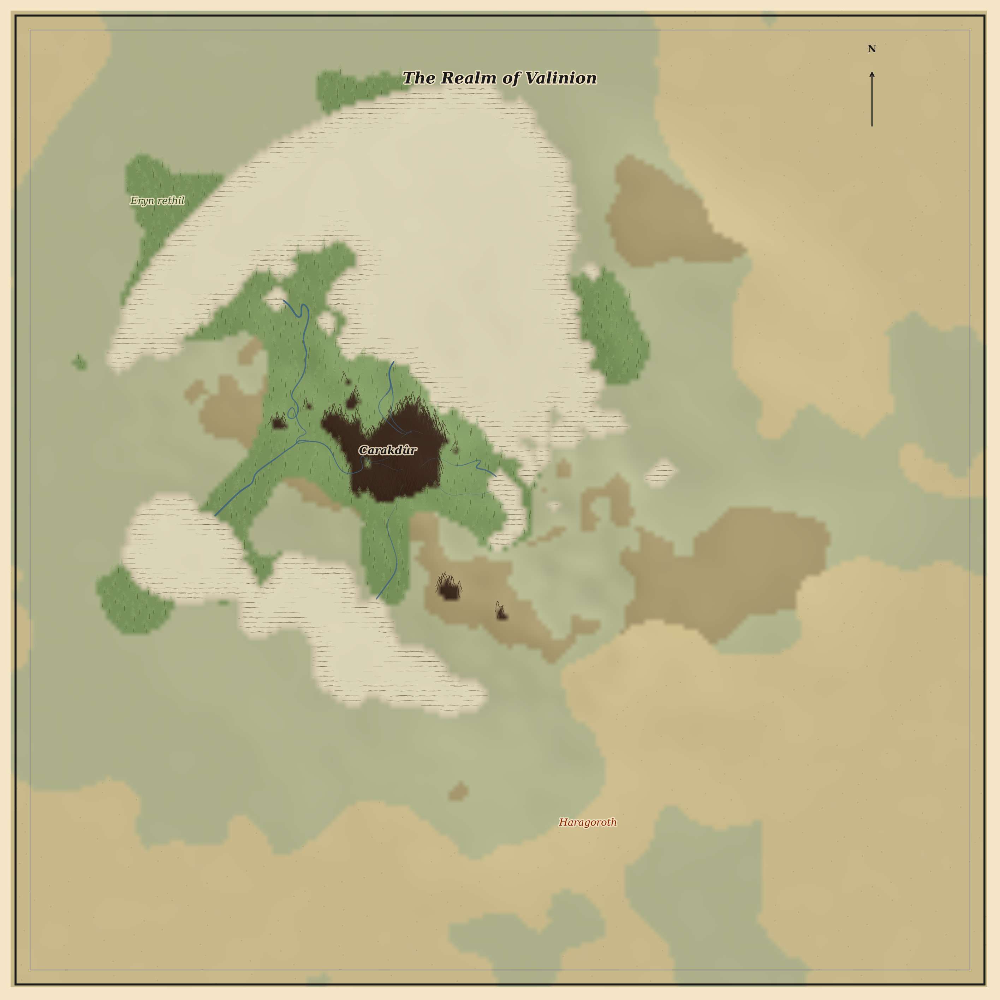

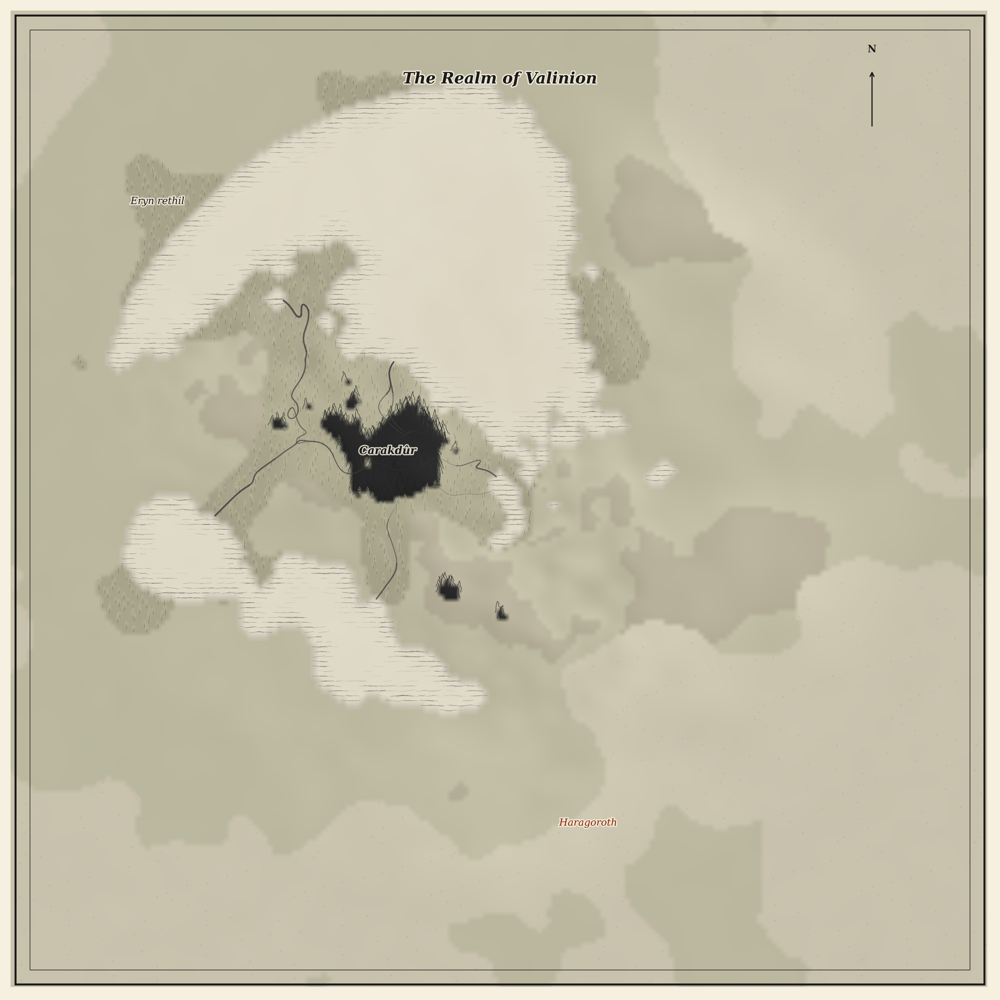

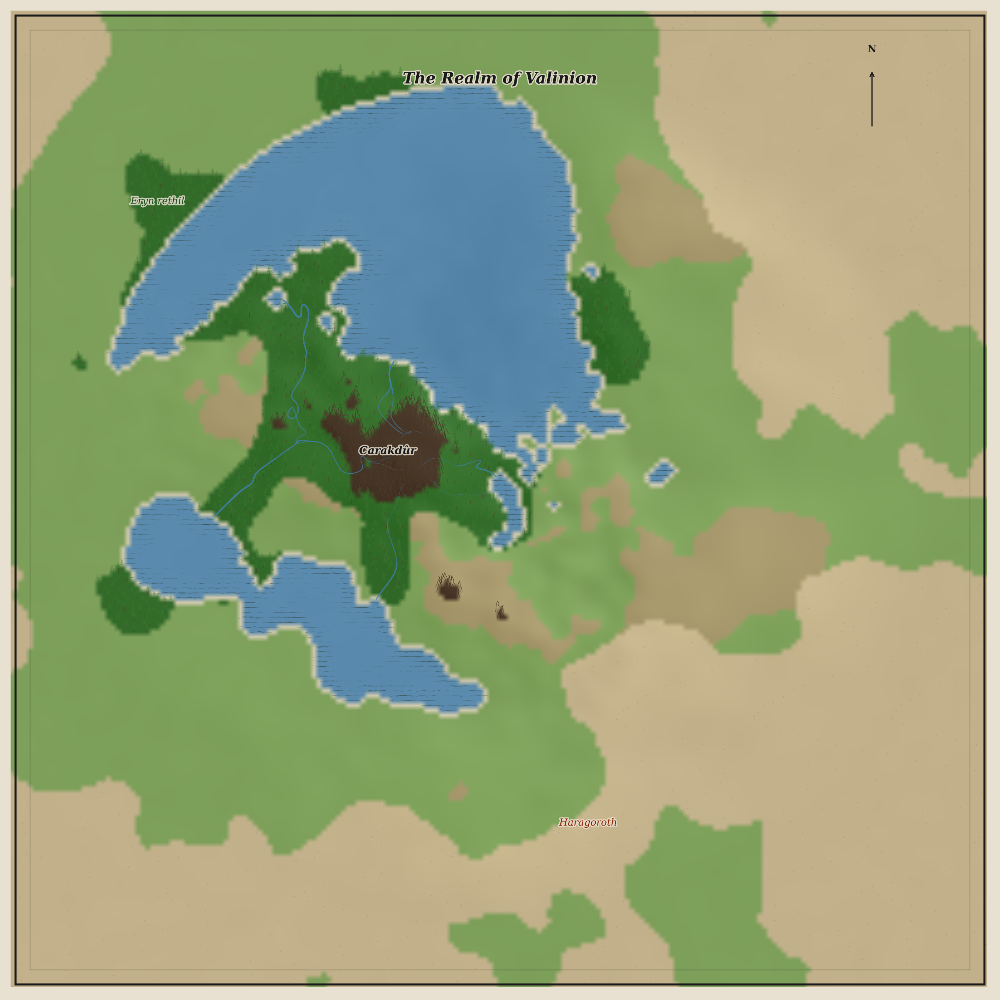

In [17]:
from IPython.display import display, Image, HTML

for name in ["map_parchment.png", "map_monochrome.png", "map_color.png"]:
    display(HTML(f"<h3 style='font-family:serif; text-align:center'>{name}</h3>"))
    display(Image(filename=name, width=900))
    display(HTML("<hr>"))

In [ ]:
# Upgrade	What it does
# cfg.WIDTH = 512	Crank resolution back up for print-quality detail
# cfg.DPI = 300	Full print resolution (24"×24" wall poster)
# cfg.SEED = <your favorite>	Lock whichever world you liked best
# More river tributaries	Fork rivers into branching systems
# Tengwar font	Install Tengwar Annatar and set fontfamily='Tengwar Annatar' for authentic Tolkien script on labels
# Coastline detail	Add small offshore islands and inlet bays
# Legend cartouche	Ornamental box in a corner with terrain symbols explained
# Road networks	Connect major named regions with dotted paths
# Cities/ruins	Small star or dot glyphs with names like "Minas Edhel"

In [18]:
"""
Tileable Mountain & Pine Glyphs v2
- Mountain: proper triangular peak, joins into ranges
- Pine: clusters into forests
- No labels, just the glyphs tiled
"""

import numpy as np
import matplotlib.pyplot as plt

# ──────────────────────────────────────────────────────────────────
# MATH
# ──────────────────────────────────────────────────────────────────

def bezier(p0, p1, p2, p3, n=60):
    t = np.linspace(0, 1, n)
    t1 = 1 - t
    x = t1**3*p0[0] + 3*t1**2*t*p1[0] + 3*t1*t**2*p2[0] + t**3*p3[0]
    y = t1**3*p0[1] + 3*t1**2*t*p1[1] + 3*t1*t**2*p2[1] + t**3*p3[1]
    return x, y

def wobble(x, y, amp=0.01, freq=5.0, seed=0):
    rng = np.random.RandomState(seed)
    t = np.linspace(0, 1, len(x))
    wave = amp * np.sin(2 * np.pi * freq * t + rng.uniform(0, 6.28))
    noise = rng.uniform(-amp * 0.4, amp * 0.4, len(x))
    dx = np.gradient(x)
    dy = np.gradient(y)
    ln = np.sqrt(dx**2 + dy**2) + 1e-10
    nx, ny = -dy / ln, dx / ln
    p = wave + noise
    return x + nx * p, y + ny * p

# ──────────────────────────────────────────────────────────────────
# MOUNTAIN — proper triangle that tiles
# ──────────────────────────────────────────────────────────────────

def draw_mountain(ax, cx=0, base_y=0, height=1.0, width=1.0,
                  skew=0.0, ink='#1A1A1A', lw=1.6, seed=42):
    """
    Triangle mountain. Left and right Béziers SHARE the exact peak point.
    Base sits at base_y, peak at base_y - height.
    skew shifts peak horizontally for variety.
    """
    rng = np.random.RandomState(seed)
    w2 = width / 2
    h = height

    # Exact shared peak
    pk_x = cx + skew
    pk_y = base_y - h

    # Left foot, right foot
    lf_x = cx - w2
    rf_x = cx + w2

    # ── Left slope → peak ──
    # Control points: slight inward curve
    p0 = (lf_x, base_y)
    p1 = (lf_x + w2 * 0.3, base_y - h * 0.25)
    p2 = (pk_x - w2 * 0.15, pk_y + h * 0.15)
    p3 = (pk_x, pk_y)  # EXACT peak
    lx, ly = bezier(p0, p1, p2, p3, n=50)
    lx, ly = wobble(lx, ly, amp=0.008 * width, freq=6, seed=seed)
    # Force endpoints exact
    lx[0], ly[0] = lf_x, base_y
    lx[-1], ly[-1] = pk_x, pk_y

    # ── Right slope: peak → right foot ──
    p0 = (pk_x, pk_y)  # EXACT peak (same point)
    p1 = (pk_x + w2 * 0.12, pk_y + h * 0.12)
    p2 = (rf_x - w2 * 0.25, base_y - h * 0.2)
    p3 = (rf_x, base_y)
    rx, ry = bezier(p0, p1, p2, p3, n=50)
    rx, ry = wobble(rx, ry, amp=0.008 * width, freq=6, seed=seed + 1)
    # Force endpoints exact
    rx[0], ry[0] = pk_x, pk_y
    rx[-1], ry[-1] = rf_x, base_y

    # Draw as single connected path so the peak joins perfectly
    full_x = np.concatenate([lx, rx[1:]])  # skip duplicate peak point
    full_y = np.concatenate([ly, ry[1:]])
    ax.plot(full_x, full_y, color=ink, linewidth=lw,
            solid_capstyle='round', solid_joinstyle='round', zorder=3)

    # ── Shadow hatching on right side ──
    n_hatch = max(3, int(8 * height))
    for i in range(n_hatch):
        frac = 0.1 + 0.7 * i / max(n_hatch - 1, 1)
        idx = int(frac * (len(rx) - 1))
        sx, sy = rx[idx], ry[idx]
        envelope = np.sin(np.pi * frac) ** 0.7
        ln = h * 0.18 * envelope * rng.uniform(0.6, 1.0)
        angle = 1.3 + rng.uniform(-0.15, 0.15)
        ex = sx + ln * 0.15 * np.cos(angle)
        ey = sy + ln * np.sin(angle)
        ts = np.linspace(0, 1, 6)
        hx = sx + (ex - sx) * ts + rng.uniform(-0.003, 0.003, 6) * width
        hy = sy + (ey - sy) * ts + rng.uniform(-0.003, 0.003, 6) * width
        ax.plot(hx, hy, color=ink, linewidth=0.4, alpha=0.45, solid_capstyle='round')


# ──────────────────────────────────────────────────────────────────
# PINE TREE — clusters well
# ──────────────────────────────────────────────────────────────────

def draw_pine(ax, cx=0, base_y=0, height=1.0, max_width=0.35,
              n_layers=5, ink='#1A1A1A', fill='#2D4A1E', seed=77):
    rng = np.random.RandomState(seed)
    h = height

    # Trunk
    lean = rng.uniform(-0.015, 0.015) * h
    tt = np.linspace(0, 1, 20)
    tx = cx + lean * tt**2
    ty = base_y - h * 0.28 * tt
    tx, ty = wobble(tx, ty, 0.003 * h, freq=3, seed=seed)
    ax.plot(tx, ty, color=ink, linewidth=1.0, solid_capstyle='round', zorder=2)

    # Branch layers
    overlap = 0.32
    usable_h = h * 0.82
    layer_h = usable_h / (n_layers * (1 - overlap) + overlap)

    for i in range(n_layers):
        frac = i / n_layers
        by = base_y - h * 0.15 - usable_h * frac * (1 - overlap)
        tip_y = by - layer_h

        w = max_width * np.exp(-1.0 * frac) * (1 - frac)**0.35
        w *= rng.uniform(0.85, 1.15)
        lcx = cx + rng.uniform(-0.008, 0.008) * h
        droop = layer_h * 0.12 * rng.uniform(0.5, 1.5)

        # Left branch
        bl0 = (lcx - w/2, by + droop)
        bl1 = (lcx - w/3, by - layer_h * 0.2)
        bl2 = (lcx - w*0.06, tip_y + layer_h * 0.25)
        bl3 = (lcx, tip_y)
        blx, bly = bezier(bl0, bl1, bl2, bl3, n=20)

        # Right branch
        br0 = (lcx, tip_y)
        br1 = (lcx + w*0.06, tip_y + layer_h * 0.25)
        br2 = (lcx + w/3, by - layer_h * 0.2)
        br3 = (lcx + w/2, by + droop)
        brx, bry = bezier(br0, br1, br2, br3, n=20)

        ox = np.concatenate([blx, brx])
        oy = np.concatenate([bly, bry])
        ox, oy = wobble(ox, oy, amp=0.006 * h, freq=7, seed=seed + i)

        ax.fill(ox, oy, color=fill, alpha=0.12, linewidth=0, zorder=2)
        ax.plot(ox, oy, color=ink, linewidth=0.6, alpha=0.65,
                solid_capstyle='round', zorder=3)

        # Needle lines
        for _ in range(2):
            nx = lcx + rng.uniform(-w*0.2, w*0.2)
            ny = by - layer_h * rng.uniform(0.2, 0.8)
            nl = layer_h * 0.08 * rng.uniform(0.5, 1.0)
            ax.plot([nx, nx + rng.uniform(-nl, nl)*0.3], [ny, ny - nl],
                    color=ink, linewidth=0.25, alpha=0.25)

    # Top spike
    ax.plot([cx, cx + rng.uniform(-0.003, 0.003)*h],
            [base_y - h*0.82, base_y - h],
            color=ink, linewidth=0.7, alpha=0.75, solid_capstyle='round', zorder=3)


# ──────────────────────────────────────────────────────────────────
# RENDER: tiled rows to show how they join
# ──────────────────────────────────────────────────────────────────

def render_glyphs():
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 10), facecolor='#F5E6C8')

    # ── Top panel: Mountain range (tiled) ──
    ax1.set_facecolor('#F5E6C8')
    rng = np.random.RandomState(42)
    base = 0.0
    # Back row (smaller, lighter)
    for i in range(9):
        x = -1.8 + i * 0.55 + rng.uniform(-0.08, 0.08)
        h = rng.uniform(0.45, 0.7)
        w = rng.uniform(0.5, 0.7)
        sk = rng.uniform(-0.04, 0.04)
        draw_mountain(ax1, cx=x, base_y=base + 0.05, height=h, width=w,
                      skew=sk, ink='#5A4A3A', lw=0.9, seed=200 + i)
    # Front row (larger, darker, overlapping)
    for i in range(7):
        x = -1.5 + i * 0.6 + rng.uniform(-0.1, 0.1)
        h = rng.uniform(0.7, 1.1)
        w = rng.uniform(0.6, 0.9)
        sk = rng.uniform(-0.06, 0.06)
        draw_mountain(ax1, cx=x, base_y=base, height=h, width=w,
                      skew=sk, ink='#1A1A1A', lw=1.6, seed=100 + i)

    ax1.set_xlim(-2.2, 2.5)
    ax1.set_ylim(-0.3, 1.3)
    ax1.invert_yaxis()
    ax1.set_aspect('equal')
    ax1.axis('off')

    # ── Bottom panel: Forest (tiled pines) ──
    ax2.set_facecolor('#F5E6C8')
    rng2 = np.random.RandomState(77)
    # Back row
    for i in range(14):
        x = -2.0 + i * 0.35 + rng2.uniform(-0.06, 0.06)
        h = rng2.uniform(0.4, 0.6)
        w = h * rng2.uniform(0.25, 0.35)
        draw_pine(ax2, cx=x, base_y=0.08, height=h, max_width=w,
                  n_layers=4, ink='#4A4A3A', fill='#3A5A2A', seed=300 + i)
    # Front row
    for i in range(10):
        x = -1.7 + i * 0.42 + rng2.uniform(-0.08, 0.08)
        h = rng2.uniform(0.65, 0.95)
        w = h * rng2.uniform(0.28, 0.38)
        draw_pine(ax2, cx=x, base_y=0.0, height=h, max_width=w,
                  n_layers=5, ink='#1A1A1A', fill='#2D4A1E', seed=400 + i)

    ax2.set_xlim(-2.2, 2.5)
    ax2.set_ylim(-0.3, 1.2)
    ax2.invert_yaxis()
    ax2.set_aspect('equal')
    ax2.axis('off')

    plt.tight_layout(pad=0.5)
    for ext in ['png', 'eps']:
        fig.savefig(f'glyphs.{ext}', dpi=300, bbox_inches='tight',
                    pad_inches=0.1, facecolor=fig.get_facecolor(), format=ext)
        print(f"Saved glyphs.{ext}")
    plt.close(fig)

render_glyphs()

Saved glyphs.png
Saved glyphs.eps


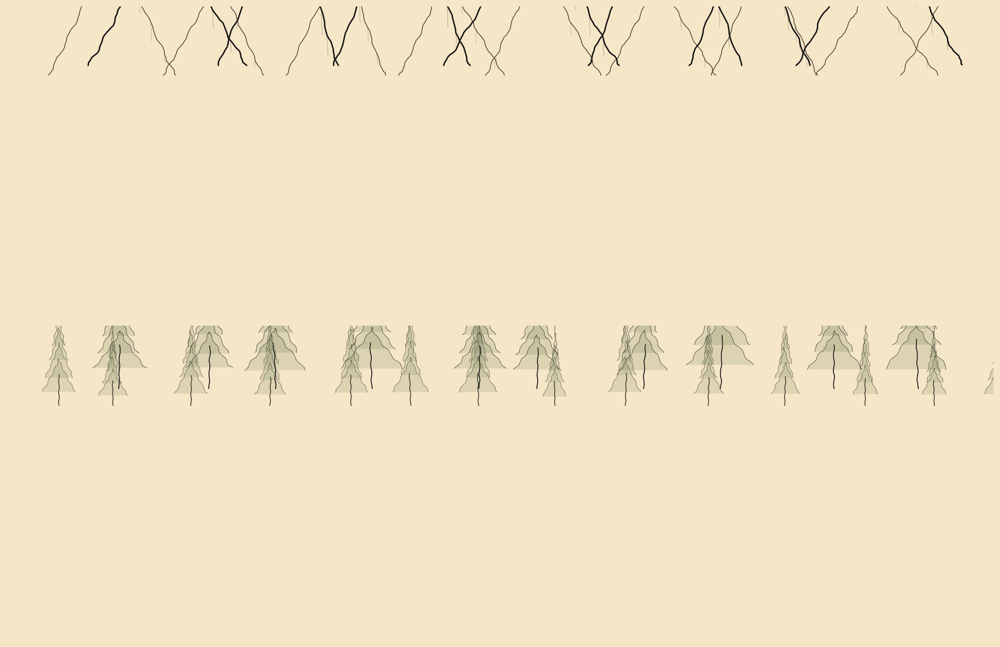

In [19]:
from IPython.display import display, Image
display(Image(filename="glyphs.png", width=1200))